# Laboratorio 6 - Modsim
### Parte 1
Cree un programa en Python (o en el lenguaje de su preferencia) para modelar la distribución de temperatura dentro
de una varilla sólida. Utilice modelado secuencial multiescala, donde combina un modelo macroscópico y un
modelo microscópico. Suponga que la varilla consta de dos materiales diferentes con diferentes conductividades
térmicas. Considere los siguientes pasos propuestos
1. Cree una función que calcule la distribución de temperatura dentro de la varilla a lo largo del tiempo utilizando un modelo macroscópico.
2. Cree una función que calcule la distribución de temperatura dentro de la varilla a lo largo del tiempo utilizando un modelo microscópico.
3. Combine ambos modelos para implementar un enfoque de modelado secuencial de múltiples escalas, donde el modelo macroscópico proporciona condiciones de contorno para el modelo microscópico.
4. Simule y visualice la distribución de temperatura dentro de la varilla durante un período de tiempo determinado.

In [34]:
import numpy as np
import matplotlib.pyplot as plt

def macroscopico(temperaturas, delta_tiempo, delta_x, conductividad_material1, conductividad_material2, num_puntos):
    nuevas_temperaturas = np.copy(temperaturas)
    for i in range(1, num_puntos - 1):
        k = conductividad_material1 if i < num_puntos // 2 else conductividad_material2
        nueva_temp = temperaturas[i] + k * delta_tiempo / delta_x**2 * (
            temperaturas[i + 1] - 2 * temperaturas[i] + temperaturas[i - 1]
        )
        nuevas_temperaturas[i] = nueva_temp
    return nuevas_temperaturas

# Visualizar la distribución de temperatura
# plt.plot(np.linspace(0, longitud_varilla, num_puntos), temperaturas)
# plt.xlabel('Posición en la varilla')
# plt.ylabel('Temperatura')
# plt.title('Distribución de temperatura en la varilla')
# plt.show()

In [35]:

def microscopic(temperaturas, conductividad_particula, delta_tiempo):
    nuevas_temperaturas = np.copy(temperaturas)
    for i in range(1, len(temperaturas) - 1):
        flujo_calor = conductividad_particula * (temperaturas[i + 1] - temperaturas[i])
        nuevas_temperaturas[i] += flujo_calor * delta_tiempo
    return nuevas_temperaturas

# Visualizar la distribución de temperatura
# plt.plot(range(num_particulas), temperaturas)
# plt.xlabel('Partícula')
# plt.ylabel('Temperatura')
# plt.title('Distribución de temperatura en el modelo microscópico')
# plt.show()

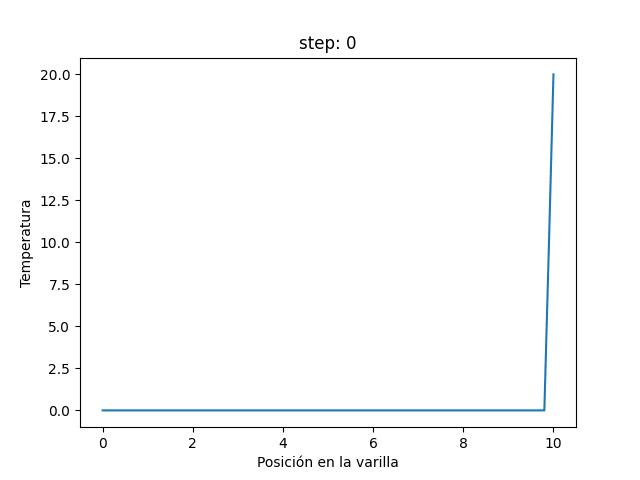

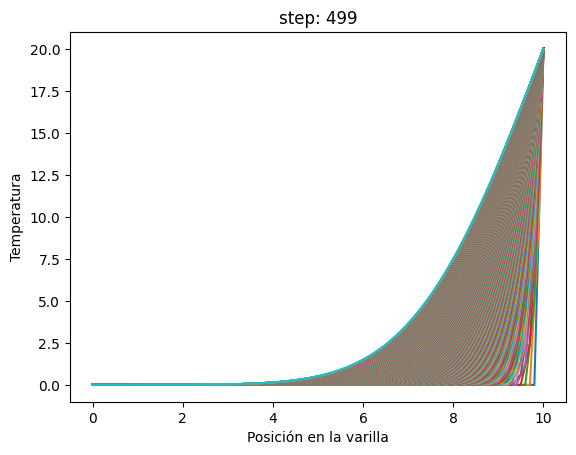

In [36]:
from IPython.display import display, Image as IPImage
from PIL import Image



# Parámetros del modelo microscópico
num_particulas = 100  # Número de partículas
conductividad_particula = 0.1  # Conductividad térmica de cada partícula
tiempo_total = 5.0  # Tiempo total de simulación
num_pasos_tiempo = 500  # Número de pasos de tiempo
delta_tiempo = tiempo_total / num_pasos_tiempo


# Parámetros de la varilla
longitud_varilla = 10.0  # Longitud de la varilla en unidades arbitrarias
num_puntos = 100  # Número de puntos en la discretización espacial
conductividad_material1 = 1.0
conductividad_material2 = 0.5

# Parámetros de la simulación
tiempo_total = 5.0  # Tiempo total de simulación
num_pasos_tiempo = 500  # Número de pasos de tiempo
delta_tiempo = tiempo_total / num_pasos_tiempo
delta_x = longitud_varilla / (num_puntos - 1)

# Inicializar temperaturas
temperaturas = np.zeros(num_puntos)

# Definir condiciones iniciales y de contorno
temperaturas[0] = 0.0  # Temperatura en el extremo izquierdo
temperaturas[-1] = 20  # Temperatura en el extremo derecho

# Inicializar temperaturas
temperaturas = np.zeros(num_puntos)

# Definir condiciones iniciales y de contorno
temperaturas[0] = 0.0  # Temperatura en el extremo izquierdo
temperaturas[-1] = 20  # Temperatura en el extremo derecho
delta_tiempo = tiempo_total / num_pasos_tiempo
delta_x = longitud_varilla / (num_puntos - 1)

iteraciones = []
list_images = []

for paso_tiempo in range(num_pasos_tiempo):
    temperaturas_micro = microscopic(temperaturas, conductividad_particula, tiempo_total / num_pasos_tiempo)
    temperaturas_macro = macroscopico(temperaturas, delta_tiempo, delta_x, conductividad_material1, conductividad_material1, num_puntos)
    temperaturas = [
        (temperaturas_micro[i] + temperaturas_macro[i]) / 2
        for i in range(len(temperaturas))
    ]
    plt.plot(np.linspace(0, longitud_varilla, num_puntos), temperaturas)
    plt.xlabel('Posición en la varilla')
    plt.ylabel('Temperatura')
    plt.title(f'step: {paso_tiempo}')
    image_name = f"./E1_images/step_{paso_tiempo}.jpg"
    plt.savefig(image_name)
    list_images.append(image_name)


images = [Image.open(path) for path in list_images]
gif_path = "ejercicio3.gif"
images[0].save(gif_path, save_all=True, append_images=images[1:], loop=0, duration=150)
display(IPImage(filename=gif_path))

**Responda:**
- a. ¿En qué se diferencia el modelo macroscópico del modelo microscópico en este escenario?
- b. ¿Cuáles son las condiciones de contorno del modelo microscópico y cómo las determina el modelo macroscópico?
- c. ¿Cómo adaptaría este modelo multiescala si la varilla estuviera compuesta por más de dos materiales diferentes?